In [1]:
import os

os.chdir('../')
os.chdir('../')

%pwd

'd:\\work\\.ghorai\\Repository\\pygeoml'

In [2]:
import sys
sys.path.append('src')
%pwd

'd:\\work\\.ghorai\\Repository\\pygeoml'

In [3]:
import warnings
import pandas as pd
import matplotlib.pyplot as plt

from feature_selection.config import ConfigManager

warnings.simplefilter(action='ignore', category=FutureWarning)


config = ConfigManager()

diconfig = config.get_dataingestion_config()

DATA_PATH = diconfig.data_file


[2023-12-26 19:33:12,572: INFO: utils]: yaml file: config.yaml loaded successfully
[2023-12-26 19:33:12,581: INFO: utils]: yaml file: params.yaml loaded successfully
[2023-12-26 19:33:12,584: INFO: utils]: create directory at: artifacts
[2023-12-26 19:33:12,586: INFO: utils]: create directory at: artifacts/data_ingestion


In [4]:
df = pd.read_csv(DATA_PATH)
df.head()

,prviSum1,prviMax1,prviMin1,prviRMS1,prviAvg1,prviMed1,prviMod1,prviVar1,prviSTD1,rfdiSum1,...,vvbyvhMod1,vvbyvhVar1,vvbyvhSTD1,gridid,geomid,pixid,crop_season,crop_year,class_name,class_id
0,-58.198951,-9.429493,-12.379228,11.693395,-11.639790,-12.066415,-12.38,1.563465,1.118379,-1.967448,...,0.49,0.000296,0.015400,108781,old_84,2932,Kharif,2022,Maize,2
1,-56.698642,-9.227584,-12.241389,11.396103,-11.339728,-11.864143,-12.24,1.602157,1.132133,-1.967382,...,0.53,0.001443,0.033972,108781,old_84,2933,Kharif,2022,Maize,2
2,-62.978038,-12.056596,-12.849531,12.598672,-12.595608,-12.716180,-12.72,0.096504,0.277855,-2.224911,...,0.42,0.001286,0.032078,108781,old_84,2935,Kharif,2022,Maize,2
3,-67.500282,-13.181876,-13.900732,13.504049,-13.500056,-13.258470,-13.90,0.134762,0.328344,-2.200395,...,0.42,0.005622,0.067064,108781,old_84,2938,Kharif,2022,Maize,2
4,-59.906036,-9.201530,-13.107331,12.067735,-11.981207,-12.280681,-13.11,2.601141,1.442537,-2.287368,...,0.40,0.000154,0.011114,108781,old_84,2939,Kharif,2022,Maize,2


In [5]:
from sklearn import preprocessing

not_useful_cols = ['gridid', 'geomid', 'pixid', 'crop_season', 'crop_year', 'class_id']
df2 = df.drop(not_useful_cols, axis=1)
label_encoder = preprocessing.LabelEncoder()
df2['class_id'] = label_encoder.fit_transform(df2['class_name'])

# normalize inputs
df3 = df2.copy()

for col in df3.columns.tolist():
    if col not in ['class_name', 'class_id']:
        minv = df3[col].min()
        maxv = df3[col].max()

        if (minv < 0) or (maxv > 1):
            df3[col] = (df3[col] - minv) / (maxv - minv)

X, y = df3.drop(['class_name', 'class_id'], axis=1), df3['class_id']


In [6]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=0)

In [7]:
# RF base model
from sklearn.ensemble import RandomForestClassifier

feature_names = X.columns.tolist()
forest = RandomForestClassifier(random_state=0)
forest.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

Text(0.5, 0, 'Random Forest Feature Importance')

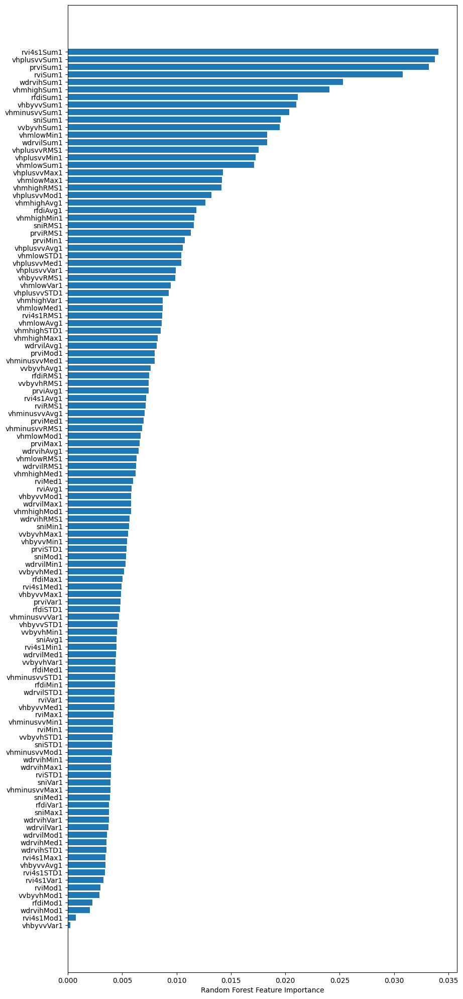

In [8]:
# FEATURE IMPORTANCE
# 1) Feature Importance built-in the Random Forest algorithm
# 2) Feature Importance computed with Permutation method
# 3) Feature Importance computed with SHAP values (SHAP -> SHapley Additive exPlanations)


# 1) Gini importance (or mean decrease impurity)
import numpy as np
import matplotlib.pyplot as plt

sorted_idx = forest.feature_importances_.argsort()
plt.figure(figsize=(10,25))
plt.barh(X.columns[sorted_idx], forest.feature_importances_[sorted_idx])
plt.xlabel("Random Forest Feature Importance")

Elapsed time to compute the importances: 95.632 seconds


Text(0.5, 0, 'Permutation Importance')

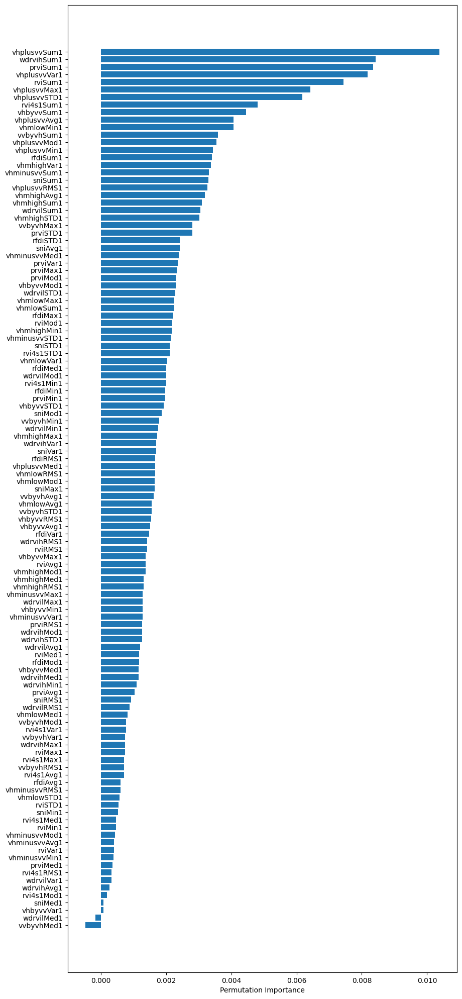

In [9]:
# Feature importance based on feature permutation
import time
from sklearn.inspection import permutation_importance

start_time = time.time()
result = permutation_importance(
    forest, X_test, y_test, n_repeats=10, random_state=42, n_jobs=2
)
elapsed_time = time.time() - start_time
print(f"Elapsed time to compute the importances: {elapsed_time:.3f} seconds")

sorted_idx = result.importances_mean.argsort()
# forest_importances = pd.Series(result.importances_mean, index=feature_names)

plt.figure(figsize=(10,25))
plt.barh(X.columns[sorted_idx], result.importances_mean[sorted_idx])
plt.xlabel("Permutation Importance")


In [10]:
import shap

explainer = shap.TreeExplainer(forest)
shap_values = explainer.shap_values(X_test)


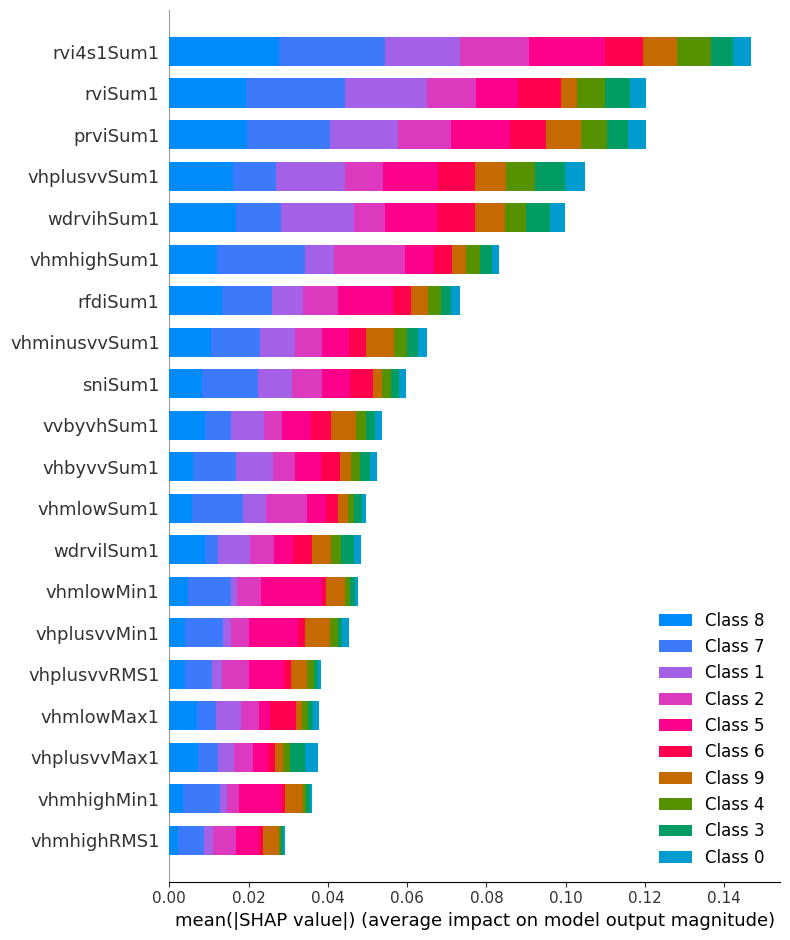

In [9]:
shap.summary_plot(shap_values, X_test) #, plot_type="bar")

### Different approaches of feature selection


### Supervised Techniques:
--------------------------
#### Wrapper-based Approach
Wrapper-based feature selection approaches include assessing the importance of features using a specific machine learning algorithm.
- Forward Selection
    - In forward selection, you start with an empty feature set and iteratively add features to the set. At each step, you evaluate the model's performance with the current feature set and the additional feature. The feature that results in the best performance improvement is added to the set.
- Backword Selection
    - The opposite of forward selection is backward selection. You begin with the entire feature set and gradually eliminate features from it.
- Recursive Feature Elimination
    - Recursive feature elimination starts with the whole feature set and eliminates features repeatedly depending on their relevance as judged by the learning algorithm.
- Exhaustive Feature Selection
    - Exhaustive feature selection compares the performance of all possible feature subsets and chooses the best-performing subset.

#### Filter-based Approach
Filter-based feature selection approaches are based on data intrinsic attributes such as feature correlation or statistics.
- Information Gain
    - Information Gain is a statistic that measures the reduction in entropy (uncertainty) for a specific feature by dividing the data according to that characteristic.
- Fisher's Score
    - Fisher's Discriminant Ratio, commonly known as Fisher's Score, is a feature selection approach that ranks features based on their ability to differentiate various classes in a dataset.
- Missing Value Ratio
    - The Missing Value Ratio is a straightforward feature selection method that makes decisions based on the number of missing values in a feature.
- Pearson's Correlation (r)
- Kendall Tau
- Spearman's Rho
- Chi-square Test
    - The Chi-square test is a statistical test used to assess the relationship between two categorical variables. It is used in feature selection to analyze the relationship between a categorical feature and the target variable.
- Mutual Info
- F-score
- Point-biserial

#### Embedded Approach
Embedded feature selection approaches include the feature selection process as part of the learning algorithm.
- Auto-encoder with bottleneck
- Regularization
    - Regularization is a method that adds a penalty term to the loss function to prevent overfitting in machine learning models. Regularization methods, such as lasso (L1 regularization) and ridge (L2 regularization), can be used in conjunction with feature selection to decrease the coefficients of less significant features towards zero, thereby picking a subset of the most relevant features.
- Random Forest Importance
    - Random forest is an ensemble learning approach that combines the predictions of several decision trees. Random forest computes a feature significance score for each feature as part of the tree-building process, which may be used to order features based on their relevance. 

### Unsupervised Techniques:
----------------------------
- PCA (Principal Component Analysis)
    - PCA is a linear dimensionality reduction method that converts the original feature space into a new orthogonal space defined by principal components. These components are linear combinations of the original features chosen to capture the highest level of variance in the data.
- ICA (Independent Component Analysis)
    - ICA is a method for dividing a multidimensional signal into its components. In the context of feature selection, ICA can be used to convert the original feature space into a new space characterized by statistically independent components. You may decrease the dimensionality of the dataset while keeping the underlying structure by picking the top k independent components.
- NMF (Non-Negative Matrix Factorization)
    - NMF is a dimensionality reduction approach that approximates a non-negative data matrix as the product of two lower-dimensional non-negative matrices.
- t-SNE (t-distributed Stochastic Neighbor Embedding)
    - t-SNE is a nonlinear dimensionality reduction method that tries to preserve the dataset's structure by reducing the difference between pairwise probability distributions in high and low-dimensional locations.
- Auto-encoder
    - An autoencoder, a kind of artificial neural network, learns to encode input data into a lower-dimensional representation and then decode it back to the original version. 
- Drop Incomplete Feature
- Drop Features with High Multi-collinearity
- Drop Feature with Near-zero Variance



Feature: vhplusvvSum1 Score: 1.2534292939089777
Feature: prviSum1 Score: 1.2068174140330221
Feature: rviSum1 Score: 1.1338959084219367
Feature: wdrvihSum1 Score: 1.107444108068531
Feature: vhbyvvSum1 Score: 1.0697071963160623
Feature: vvbyvhSum1 Score: 1.0510027662994839
Feature: wdrvilSum1 Score: 1.0370628552699142
Feature: vhmlowSum1 Score: 1.0237128201484733
Feature: sniSum1 Score: 1.023041605734825
Feature: rvi4s1Sum1 Score: 1.0177291997505238
Feature: rfdiSum1 Score: 1.0130620809590525
Feature: vhminusvvSum1 Score: 1.0035415040871882
Feature: vhmhighSum1 Score: 0.9678358784042516
Feature: vhplusvvMed1 Score: 0.9402959946678777
Feature: vhplusvvAvg1 Score: 0.9381462629155246
Feature: vhplusvvRMS1 Score: 0.9332582854138014
Feature: vhplusvvMod1 Score: 0.8835863274161815
Feature: vhplusvvMax1 Score: 0.87794713460237
Feature: vhmhighAvg1 Score: 0.8440521694956207
Feature: vhmhighRMS1 Score: 0.8422014676174596
Feature: vhmlowAvg1 Score: 0.834810206122258
Feature: vhplusvvMin1 Score: 0.

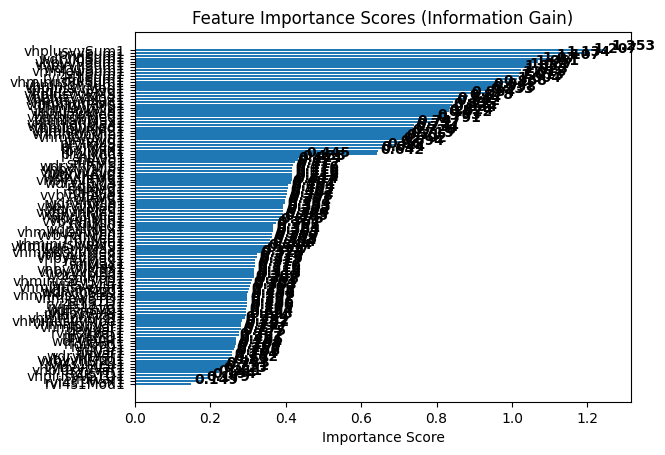

In [10]:
# Information Gain
#=================================
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_regression

# Apply Information Gain
ig = mutual_info_regression(X, y)

# Create a dictionary of feature importance scores
feature_scores = {}
for i in range(len(X.columns)):
    feature_scores[X.columns[i]] = ig[i]

# Sort the features by importance score in descending order
sorted_features = sorted(feature_scores.items(), key=lambda x: x[1], reverse=True)

# Print the feature importance scores and the sorted features
for feature, score in sorted_features:
    print('Feature:', feature, 'Score:', score)

# Plot a horizontal bar chart of the feature importance scores
fig, ax = plt.subplots()
y_pos = np.arange(len(sorted_features))
ax.barh(y_pos, [score for feature, score in sorted_features], align="center")
ax.set_yticks(y_pos)
ax.set_yticklabels([feature for feature, score in sorted_features])
ax.invert_yaxis()  # Labels read top-to-bottom
ax.set_xlabel("Importance Score")
ax.set_title("Feature Importance Scores (Information Gain)")

# Add importance scores as labels on the horizontal bar chart
for i, v in enumerate([score for feature, score in sorted_features]):
    ax.text(v + 0.01, i, str(round(v, 3)), color="black", fontweight="bold")
plt.show()

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the doc

Selected Features: ('prviSum1', 'rviRMS1', 'vhmlowSTD1', 'sniMod1', 'vhplusvvMed1')
Accuracy: 0.670816240649358


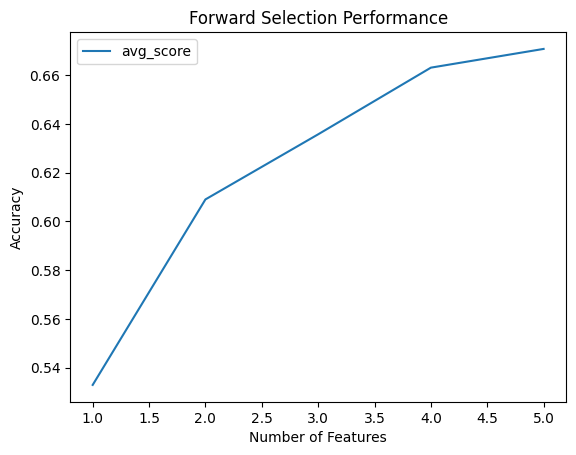

In [12]:
# Forward Selection
#=============================
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from mlxtend.feature_selection import SequentialFeatureSelector as SFS

# Define the logistic regression model
model = LogisticRegression()

# Define the forward selection object
sfs = SFS(model,
          k_features=5,
          forward=True,
          floating=False,
          scoring='accuracy',  # use 'r2' if target is regression
          cv=5)

# Perform forward selection on the training set
sfs.fit(X_train, y_train)

# Print the selected features
print('Selected Features:', sfs.k_feature_names_)

# Evaluate the performance of the selected features on the testing set
accuracy = sfs.k_score_
print('Accuracy:', accuracy)

# Plot the performance of the model with different feature subsets
sfs_df = pd.DataFrame.from_dict(sfs.get_metric_dict()).T
sfs_df['avg_score'] = sfs_df['avg_score'].astype(float)
fig, ax = plt.subplots()
sfs_df.plot(kind='line', y='avg_score', ax=ax)
ax.set_xlabel('Number of Features')
ax.set_ylabel('Accuracy')
ax.set_title('Forward Selection Performance')
plt.show()

# create a result df
sfs_results = pd.DataFrame(sfs.subsets_).transpose()
sfs_results


In [13]:
# Backward Feature Elemination
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.linear_model import LinearRegression

import pandas as pd
import numpy as np

sfs = SFS(LinearRegression(),
          k_features=5,
          forward=False,
          floating=False,
          scoring='r2',  # use 'accuracy' if target is classification
          cv=5)

sfs.fit(X_train, y_train)

# create a result df
sfs_results = pd.DataFrame(sfs.subsets_).transpose()
sfs_results



,feature_idx,cv_scores,avg_score,feature_names
117,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[-36401.408620388385, 0.25010668845607564, 0.2...",-7281.071564,"(prviSum1, prviMax1, prviMin1, prviRMS1, prviA..."
116,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[-32.67845700877084, 0.24947716110336582, 0.24...",-8.367486,"(prviSum1, prviMax1, prviMin1, prviRMS1, prviA..."
115,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[-10.693079374797758, 0.25357619544756393, 0.2...",-2.180661,"(prviSum1, prviMax1, prviMin1, prviRMS1, prviA..."
114,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[0.24863531004554185, 0.25222742187418046, 0.2...",0.199153,"(prviSum1, prviMax1, prviMin1, prviRMS1, prviA..."
113,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[0.2550040947082587, 0.2552496836835304, 0.243...",0.252326,"(prviSum1, prviMax1, prviMin1, prviRMS1, prviA..."
...,...,...,...,...
9,"(12, 13, 18, 57, 58, 61, 84, 85, 90)","[-115.30416339772202, 0.15059678107699326, 0.1...",-22.943781,"(rfdiRMS1, rfdiAvg1, rvi4s1Sum1, sniRMS1, sniA..."
8,"(12, 13, 18, 57, 58, 84, 85, 90)","[-52.674743805932586, 0.1349760032668701, 0.11...",-10.427406,"(rfdiRMS1, rfdiAvg1, rvi4s1Sum1, sniRMS1, sniA..."
7,"(12, 13, 57, 58, 84, 85, 90)","[-0.013299318143477734, 0.059184195552478336, ...",0.047176,"(rfdiRMS1, rfdiAvg1, sniRMS1, sniAvg1, vhminus..."
6,"(12, 13, 57, 84, 85, 90)","[-0.11797096461141932, 0.049736191407072194, 0...",0.016371,"(rfdiRMS1, rfdiAvg1, sniRMS1, vhminusvvRMS1, v..."


In [15]:
# Exhaustive Feature Selector
from mlxtend.feature_selection import ExhaustiveFeatureSelector as EFS
from sklearn.linear_model import LinearRegression

lr = LinearRegression()

efs = EFS(LinearRegression(),
          min_features=5,
          max_features=10,
          scoring='accuracy',  # use 'r2' if target is regression
          cv=5)

efs.fit(X_train, y_train)

print('Best subset (indices):', efs.best_idx_)
print('Best subset (corresponding names):', efs.best_feature_names_)

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "d:\mlenv\lib\site-packages\sklearn\metrics\_scorer.py", line 115, in __call__
    score = scorer._score(cached_call, estimator, *args, **kwargs)
  File "d:\mlenv\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "d:\mlenv\lib\site-packages\sklearn\utils\_param_validation.py", line 192, in wrapper
    return func(*args, **kwargs)
  File "d:\mlenv\lib\site-packages\sklearn\metrics\_classification.py", line 221, in accuracy_score
    y_type, y_true, y_pred = _check_targets(y_true, y_pred)
  File "d:\mlenv\lib\site-packages\sklearn\metrics\_classification.py", line 95, in _check_targets
    raise ValueError(
ValueError: Classification metrics can't handle a mix of multiclass and continuous targets

Scoring failed. The score on this train-test parti

In [ ]:
# LASSO Regularization  (L1)
# ============================

from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import SelectFromModel
from sklearn.preprocessing import StandardScaler


scaler = StandardScaler()
scaler.fit(X_train)
scaled_features = scaler.transform(X_train)

logistic = SelectFromModel(LogisticRegression(C=1, penalty='l1', solver='liblinear'))
logistic.fit(X_train, y_train)

selected_features = X_train.columns[(logistic.get_support())]

print('Total number of features: {}'.format((X_train.shape[1])))
print('Features selected: {}'.format(len(selected_features)))
print('Number of discarded features: {}'.format(np.sum(logistic.estimator_.coef_==0)))

X_train.columns[(logistic.estimator_.coef_==0).ravel()]

In [ ]:
# RF Feature Importance
# ==========================
from sklearn.ensemble import RandomForestClassifier


classifier = RandomForestClassifier(random_state=90, oob_score=True)
classifier.fit(X_train, y_train)

feature_importance = classifier.feature_importances_ 
feature_importance = 100.0*(feature_importance / feature_importance.max())

sorted_idx = np.argsort(feature_importance)
sorted_idx = sorted_idx[len(feature_importance) - 50:]

pos = np.arange(sorted_idx.shape[0]) + 0.5

plt.figure(figsize=(10,12))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.xticks(size=14)
plt.yticks(pos, X_train.columns[sorted_idx], size=14)
plt.xlabel('Relative Importance', fontsize=15)
plt.title('Variable Importance', fontsize=15)
plt.show()

In [ ]:
# Mutual Information
# ==================

from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import mutual_info_regression

ml_type = 'classification'

if ml_type == 'classification':
    mutual_information = mutual_info_classif(X_train, y_train)
else:
    mutual_information = mutual_info_regression(X_train, y_train)

mutual_information_series = pd.Series(mutual_information)

mutual_information_series.index = X_train.columns

mutual_information_series.sort_values(ascending=False)
mutual_information_series.sort_values(ascending=False).plot.bar()

In [37]:
# Variance Threshold
# ==================

from sklearn.feature_selection import VarianceThreshold
selector = VarianceThreshold(threshold=0.05)
selector.fit(X_train)

best_features = X_train.columns[selector.get_support()]
print(best_features)

In [ ]:
# Chi-squared Test
# ==================

from sklearn.feature_selection import SelectKBest, chi2

chi2_features = SelectKBest(chi2, k=4)
best_k_features = chi2_features.fit_transform(X_train, y_train)

print("Total number of features", X_train.shape[1])
print("Reduced to {} features".format(best_k_features.shape[1]))

In [ ]:
# PCA
#==================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


feature_names = X_train.columns

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)

# Perform PCA
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# Calculate the explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

# Create a 2x1 grid of subplots
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(16, 8))

# Plot the explained variance ratio in the first subplot
ax1.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio)
ax1.set_xlabel("Principal Component")
ax1.set_ylabel("Explained Variance Ratio")
ax1.set_title("Explained Variance Ratio by Principal Component")

# Calculate the cumulative explained variance
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

# Plot the cumulative explained variance in the second subplot
ax2.plot(
    range(1, len(cumulative_explained_variance) + 1),
    cumulative_explained_variance,
    marker="o",
)
ax2.set_xlabel("Number of Principal Components")
ax2.set_ylabel("Cumulative Explained Variance")
ax2.set_title("Cumulative Explained Variance by Principal Components")

# Display the figure
plt.tight_layout()
plt.show()

In [38]:
# high multi-collinearity check
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_scores = [variance_inflation_factor(X.values, feature)for feature in range(len(X.columns))]

In [ ]:
# Recursive Feature Elimination
#=====================================
from sklearn.feature_selection import RFE
from sklearn.svm import SVC

svc = SVC(kernel="linear")
rfe = RFE(svc, n_features_to_select=3)
rfe.fit(X_train, y_train)
X_selection = rfe.transform(X_train)
X_selection


In [ ]:
# Univariate selection
# ================================

#  keep the top 2 features with the strongest Pearson correlation with the target
from sklearn.feature_selection import r_regression, SelectKBest
X_selection = SelectKBest(r_regression, k=2).fit_transform(X_train, y_train)
print(X_selection)

# keep the top 30% of features
from sklearn.feature_selection import r_regression, SelectPercentile
X_selection = SelectPercentile(r_regression, percentile=30).fit_transform(X_train, y_train)
print(X_selection)

In [ ]:
# Spearman’s Rho, Kendall Tau, and point-biserial correlation are all available in the scipy package
#==================================================================================================
from scipy import stats

rho_corr = [stats.spearmanr(X[:, f], y).correlation for f in range(X.shape[1])]

tau_corr = [stats.kendalltau(X[:, f], y).correlation for f in range(X.shape[1])]

pbs_corr = [stats.pointbiserialr(X[:, f], y).correlation for f in range(X.shape[1])]

In [ ]:
# ANOVA F-score are all in scikit-learn
#===================================================
from sklearn.feature_selection import f_classif

f_corr = f_classif(X, y)[0]


In [ ]:
# Cramer’s V can be obtained from a recent scipy version
#=================================================================
from scipy.stats.contingency import association

v_corr = [association(np.hstack([X[:, f].reshape(-1, 1), y.reshape(-1, 1)]), method="cramer") for f in range(X.shape[1])]

In [ ]:
# Which feature selection method to choose? Build yourself a voting selector
# The implementation inspired by ensembled decision trees.
# 1) A filter method based on Pearson correlation.
# 2) An unsupervised method based on multicollinearity.
# 3) A wrapper, Recursive Feature Elimination.

from itertools import compress

import pandas as pd
from sklearn.feature_selection import RFE, r_regression, SelectKBest
from sklearn.svm import SVR
from statsmodels.stats.outliers_influence import variance_inflation_factor


class VotingSelector():
   def __init__(self):
       self.selectors = {
           "pearson": self._select_pearson,
           "vif": self._select_vif,
           "rfe": self._select_rfe,
       }
       self.votes = None

   @staticmethod
   def _select_pearson(X, y, **kwargs):
       selector = SelectKBest(r_regression, k=kwargs.get("n_features_to_select", 5)).fit(X, y)
       return selector.get_feature_names_out()

   @staticmethod
   def _select_vif(X, y, **kwargs):
       return [
           X.columns[feature_index]
           for feature_index in range(len(X.columns))
           if variance_inflation_factor(X.values, feature_index) <= kwargs.get("vif_threshold", 10)
       ]

   @staticmethod
   def _select_rfe(X, y, **kwargs):
       svr = SVR(kernel="linear")
       rfe = RFE(svr, n_features_to_select=kwargs.get("n_features_to_select", 5))
       rfe.fit(X, y)
       return rfe.get_feature_names_out()

   def select(self, X, y, voting_threshold=0.5, **kwargs):
       votes = []
       for selector_name, selector_method in self.selectors.items():
           features_to_keep = selector_method(X, y, **kwargs)
           votes.append(
               pd.DataFrame([int(feature in features_to_keep) for feature in X.columns]).T
           )
       self.votes = pd.concat(votes)
       self.votes.columns = X.columns
       self.votes.index = self.selectors.keys()
       features_to_keep = list(compress(X.columns, self.votes.mean(axis=0) > voting_threshold))
       return X[features_to_keep]
   

# vs = VotingSelector()
# X_selection = vs.select(X, y)

vs = VotingSelector()
X_selection = vs.select(X, y, n_features_to_select=10, vif_threshold=15)